---
# PRImA Layout Dataset
### STEP 1: Data Analysis
---

In [1]:
import os
import xml.etree.ElementTree as ET
import cv2
import matplotlib.pyplot as plt
import numpy as np

# Matplotlin configuration
plt.rcParams['figure.figsize'] = [10, 10]


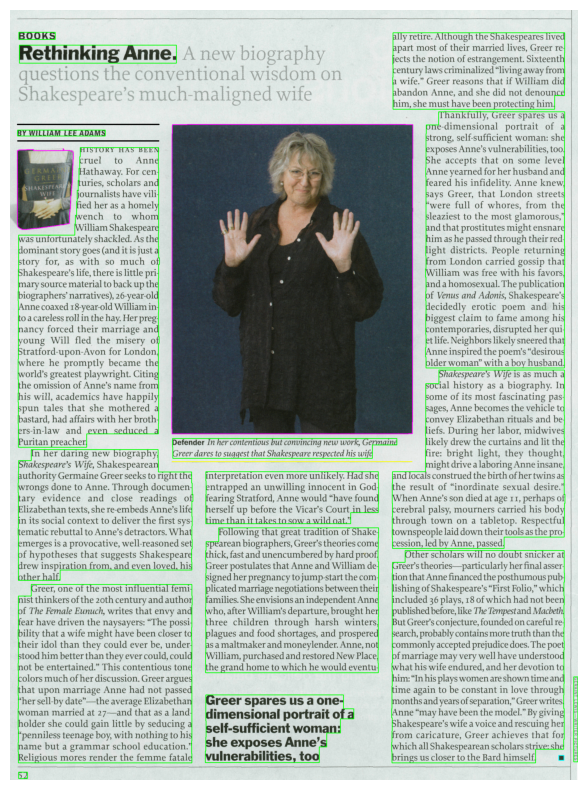

In [6]:
img_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\PRImA Layout Analysis Dataset\Images"
xml_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\PRImA Layout Analysis Dataset\XML"

img_files = os.listdir(img_folder)
xml_files = os.listdir(xml_folder)

# Define colors for labels

label_colors = {

        "TextRegion": (0, 255, 0),     
        "ImageRegion": (255, 0, 255), 
        "GraphicRegion": (255, 255, 0),
        "NoiseRegion": (0, 255, 255),
        "ChartRegion": (255, 0, 0),
        "TableRegion": (0, 0, 255),
        "SeparatorRegion": (0, 0, 0),
        "MathsRegion": (255, 255, 255),
        "LineDrawingRegion": (128, 128, 128)   
    }

def plot_img_with_labels(img_folder, xml_folder, img_file_name):

    try:

        img_path = os.path.join(img_folder, img_file_name)
        xml_file_name = img_file_name.split('.')[0] + '.xml'
        xml_path = os.path.join(xml_folder, xml_file_name)
       
        img = cv2.imread(img_path)

        tree = ET.parse(xml_path)
        root = tree.getroot()

        for region in root.findall('.//{*}TextRegion') + root.findall('.//{*}ImageRegion')+ root.findall('.//{*}GraphicRegion')+ root.findall('.//{*}NoiseRegion')+ root.findall('.//{*}ChartRegion')+ root.findall('.//{*}TableRegion')+ root.findall('.//{*}SeparatorRegion')+ root.findall('.//{*}MathsRegion')+ root.findall('.//{*}LineDrawingRegion'):
            
            coords = []
            label = region.tag.split('}')[1]  # Extract the label from the tag name
        
            for point in region.find('.//{*}Coords'):
                x, y = int(point.attrib['x']), int(point.attrib['y'])
                coords.append((x, y))
            coords = [coords]
            coords = np.array(coords)

            # Draw bounding box on image with corresponding color
            color = label_colors.get(label, (0, 0, 0))  # Default to black if label not found
            cv2.polylines(img, [coords], isClosed=True, color=color, thickness=2)

            # Add label next to bounding box
            x, y = coords[0][0]
            #cv2.putText(img, label, (x, y), cv2.FONT_HERSHEY_SIMPLEX, 1.9, color,  5)
        

        plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        plt.axis('off')
        plt.show()


    except Exception as e:
        pass

img_files = os.listdir(img_folder)

import random
i = random.randint(0, len(img_files)-1)

img_file = img_files[i]
plot_img_with_labels(img_folder, xml_folder, img_file)


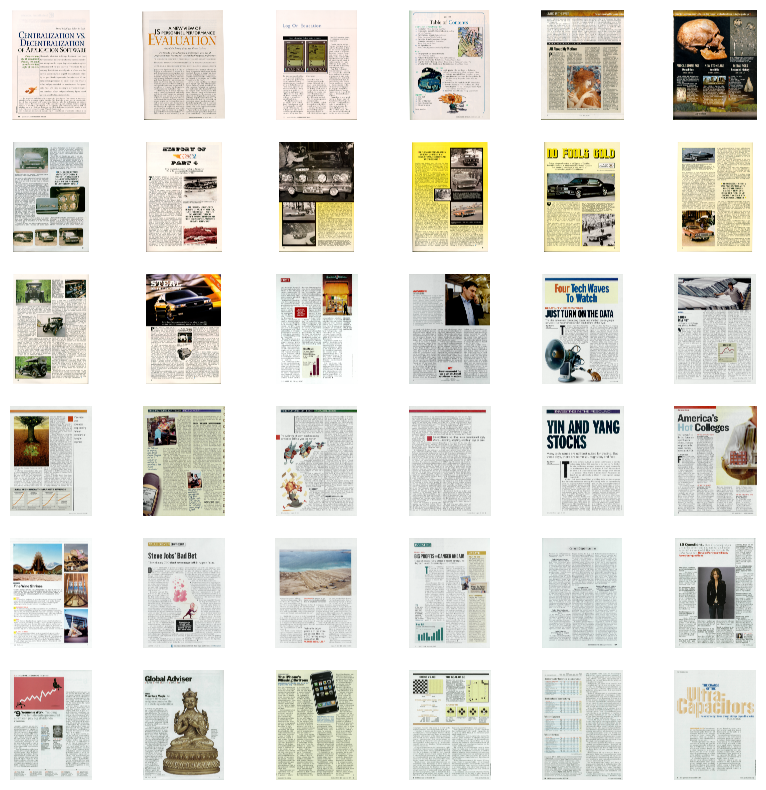

In [3]:
# Plot 6 x 6 grid of images from dataset

fig, axs = plt.subplots(6, 6)

for i in range(6):
    for j in range(6):
        img_file = img_files[i*6 + j]
        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)
        axs[i, j].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
        axs[i, j].axis('off')


---
### STEP 2: Synthetic Dataset
---

- Obtaining the Images Crops to include

In [ ]:
import os
import requests
from bs4 import BeautifulSoup

def download_google_images(query, folder, num_images=30):
    if not os.path.exists(folder):
        os.makedirs(folder)

    url = f'https://www.google.com/search?q={query}&source=lnms&tbm=isch&tbs=ift:jpg,tbs=isz:l,tbs=isz:lt,islt:4mp'

    response = requests.get(url)
    html = response.text

    soup = BeautifulSoup(html, 'html.parser')
    img_tags = soup.find_all('img')

    for i, img_tag in enumerate(img_tags[:num_images]):

        #print(img_tag)
        img_url = img_tag.get('src')
        if img_url:
            img_name = f"{query}_{i}.jpg"
            img_path = os.path.join(folder, img_name)
            try:
                img_data = requests.get(img_url).content
                with open(img_path, 'wb') as img_file:
                    img_file.write(img_data)
                    print(f"Downloaded {img_name}")
            except Exception as e:
                print(f"Error downloading {img_name}: {e}")
        else:
            print(f"No data-src attribute found for image {i}")

def plot_img_from_folder(folder, num =5):

    google_img_files = os.listdir(folder)
    
    fig, axs = plt.subplots(num, num)
    for i in range(num):
        for j in range(num):
            img_file = google_img_files[i*num + j]
            img_path = os.path.join(folder, img_file)
            img = cv2.imread(img_path)
            axs[i, j].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axs[i, j].axis('off')


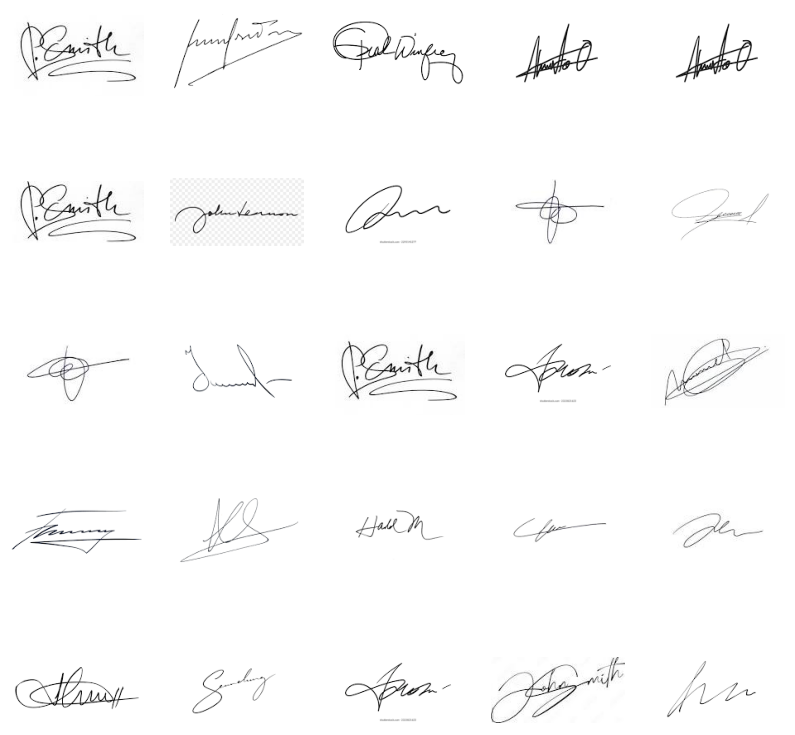

In [ ]:

google_images_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Google Images\Signatures"
query = "firma de persona"
download_google_images(query, google_images_folder)

plot_img_from_folder(google_images_folder)


In [ ]:
google_images_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Google Images\Logos"
query = "bank logo"
download_google_images(query, google_images_folder)

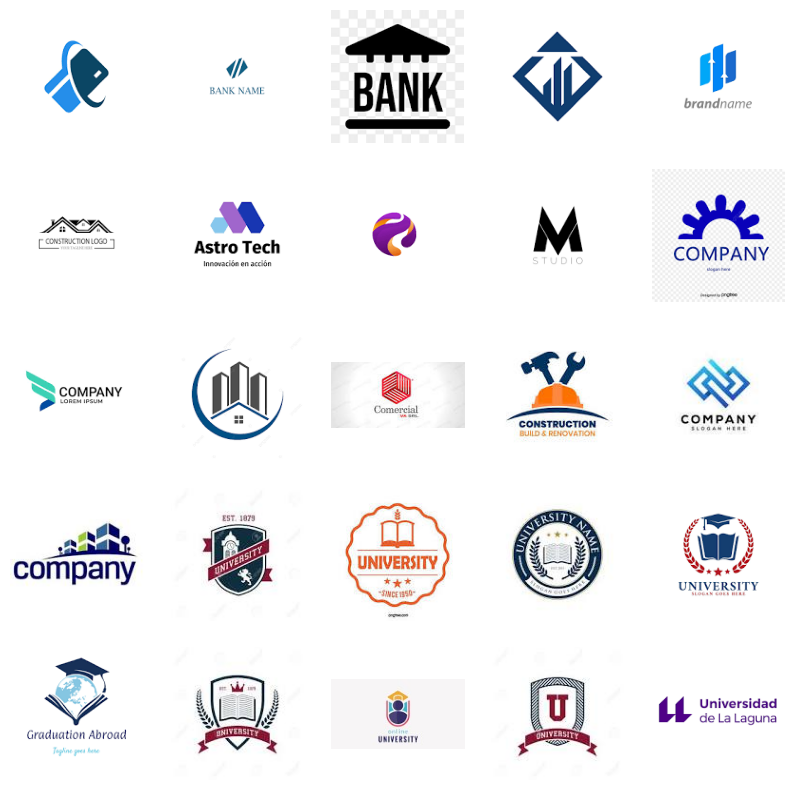

In [ ]:
plot_img_from_folder(google_images_folder, 5)

In [ ]:
google_images_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Google Images\Stamps"
query = "Sello de empresa tinta Imagen PNG"
download_google_images(query, google_images_folder)

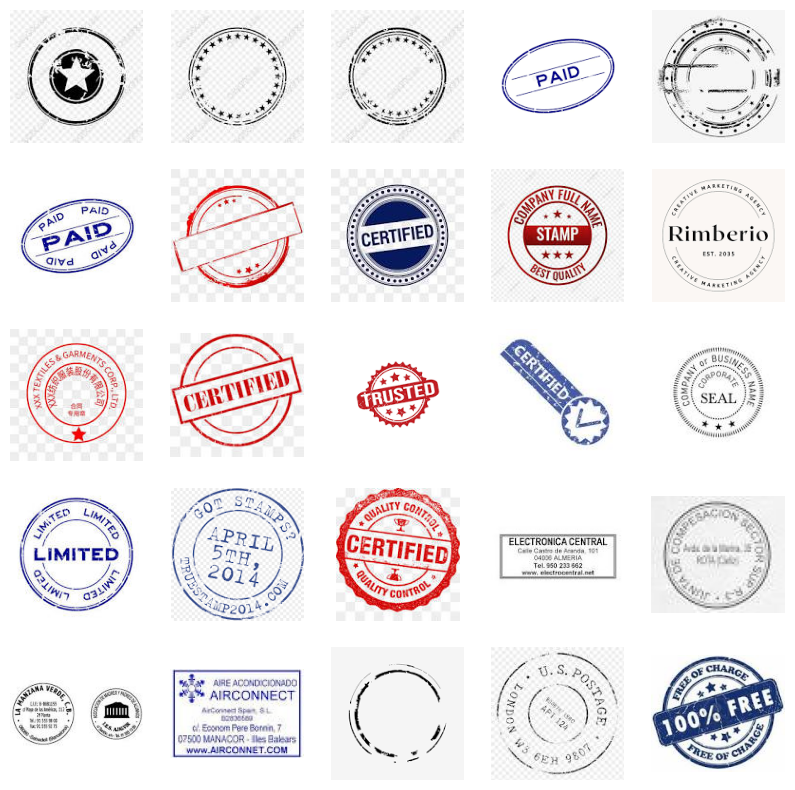

In [ ]:
plot_img_from_folder(google_images_folder, 5)

In [ ]:
google_images_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Google Images\Graphs"
query = "graphs"
download_google_images(query, google_images_folder)

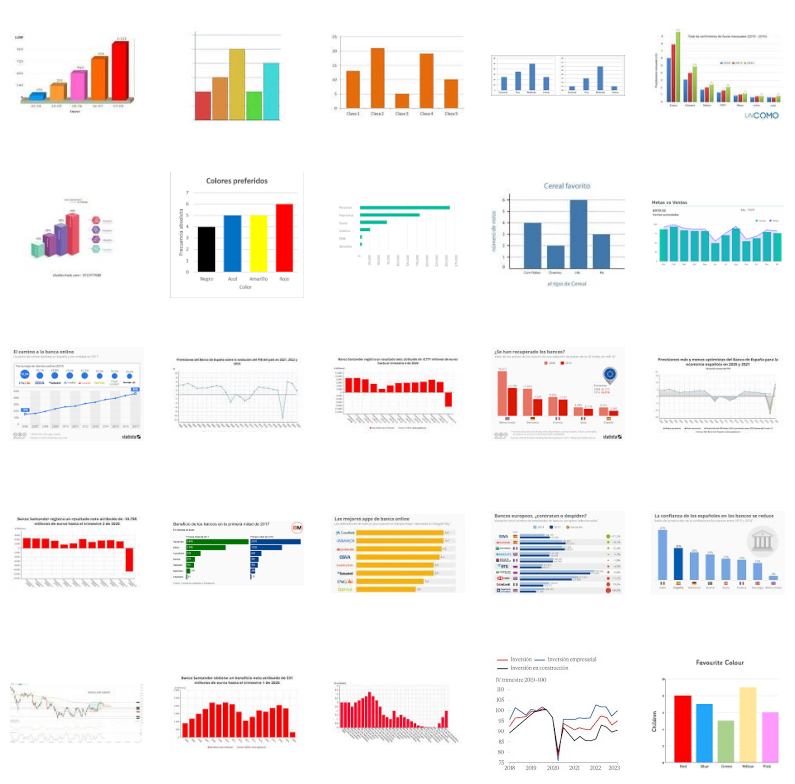

In [ ]:
plot_img_from_folder(google_images_folder, 5)

- Creating Synthetic Dataset

In [11]:
import os
import sys
import cv2
import numpy as np
import pandas as pd
from PIL import Image
import albumentations as A
import glob
import matplotlib.pyplot as plt
import xmltodict
import json
from tqdm.notebook import tqdm
from pycocotools.coco import COCO
import random
import os
import xml.etree.ElementTree as ET

root_dir = r"C:\\Users\\User\\OneDrive\\Escritorio\\Detectron2LayoutParser\\PRImA Layout Analysis Dataset\\"
img_dir = "Images/"
anno_dir = "XML/"
final_root_dir="Document_Layout_Analysis/" 

if not os.path.exists(final_root_dir):
    os.makedirs(final_root_dir)

if not os.path.exists(final_root_dir+img_dir):
    os.makedirs(final_root_dir+img_dir)

if not os.path.exists(final_root_dir+img_dir):
    os.makedirs(final_root_dir+anno_dir)

In [ ]:
# Images conversion

n = root_dir+img_dir+'*.tif'

for name in glob.glob(n):
    im = Image.open(name)
    name = str(name).rstrip(".tif")
    name = str(name).lstrip(root_dir)
    name = str(name).lstrip(img_dir)
    im.save(final_root_dir+ img_dir+ name + '.jpg', 'JPEG')

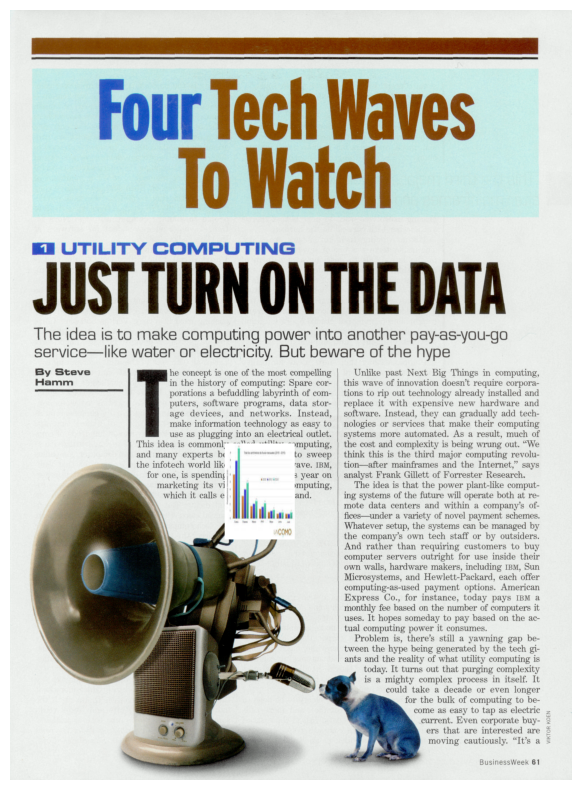

In [ ]:
img_name = '00000190'
image = cv2.imread(root_dir+img_dir+img_name+'.tif')

try:
    xml = open(root_dir+anno_dir+img_name+'.xml').read()
    xml_path = root_dir+anno_dir+img_name+'.xml'
except:
    xml = open(root_dir+anno_dir+"pc-"+img_name+'.xml').read()
    xml_path = root_dir+anno_dir+"pc-"+img_name+'.xml'

# Select randomly one folder and one image from the google images folder 

google_images_folder = r"C:\\Users\\User\\OneDrive\\Escritorio\\Detectron2LayoutParser\\Google Images\\"

google_folders = os.listdir(google_images_folder)
selected_folder = random.choice(google_folders)

google_images_folder = os.path.join(google_images_folder, selected_folder)
google_img_files = os.listdir(google_images_folder)
img_file = random.choice(google_img_files)

added_img = cv2.imread(os.path.join(google_images_folder, img_file))

# Add img to random location in the image
h, w, _ = image.shape
random_red = random.randint(6, 8)
resized_added_img = cv2.resize(added_img, (w//random_red, h//random_red))
h_added, w_added, _ = resized_added_img.shape

# Avoid overlapping with XML regions
tree = ET.parse(xml_path)
root = tree.getroot()

x = random.randint(0, w - w_added)
y = random.randint(0, h - h_added)

x2, y2 = x + w_added, y + h_added

added_img = image.copy()
added_img[y:y2, x:x2] = resized_added_img

ET.register_namespace('', 'http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19')
ET.register_namespace('xsi', 'http://www.w3.org/2001/XMLSchema-instance')

# Create the new ImageRegion element
new_image_region = ET.Element("ImageRegion")
new_image_region.set("id", "r100100")
new_image_region.set("orientation", "0.00000")
new_image_region.set("readingOrientation", "0.00000")
new_image_region.set("readingDirection", "left-to-right")
new_image_region.set("type", "paragraph")
new_image_region.set("textColour", "black")
new_image_region.set("primaryLanguage", "English")
new_image_region.set("primaryScript", "Latin")
new_image_region.set("bgColour", "white")

coords = ET.SubElement(new_image_region, "{http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19}Coords")
points = [(x, y), (x2, y), (x2, y2), (x, y2)]

for p in points:
    point = ET.SubElement(coords, "{http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19}Point")
    x, y = p
    point.set("x", str(x))
    point.set("y", str(y))

root.append(new_image_region)

# Specify the file path for the new XML file
xml_str = img_name + '_new.xml'
new_xml_file = os.path.join(final_root_dir, anno_dir, xml_str)
tree.write(new_xml_file, encoding="utf-8", xml_declaration=True)

plt.imshow(added_img)
plt.axis('off')
plt.show()


In [ ]:
def generate_xml_files():

    for img_name in os.listdir(final_root_dir+img_dir):
      
        image = cv2.imread(final_root_dir+img_dir+img_name)
        img_name = img_name.split('.')[0]

        try:
            xml = open(root_dir+anno_dir+img_name+'.xml').read()
            xml_path = root_dir+anno_dir+img_name+'.xml'

        except:

            try:
                xml = open(root_dir+anno_dir+"pc-"+img_name+'.xml').read()
                xml_path = root_dir+anno_dir+"pc-"+img_name+'.xml'

            except:
                print("No directory found...")
         
        google_images_folder = r"C:\\Users\\User\\OneDrive\\Escritorio\\Detectron2LayoutParser\\Google Images\\"

        google_folders = os.listdir(google_images_folder)
        selected_folder = random.choice(google_folders)

        google_images_folder = os.path.join(google_images_folder, selected_folder)
        google_img_files = os.listdir(google_images_folder)
        img_file = random.choice(google_img_files)

        added_img = cv2.imread(os.path.join(google_images_folder, img_file))

        # Add img to random location in the image
        h, w, _ = image.shape
        random_red = random.randint(4, 8)
        resized_added_img = cv2.resize(added_img, (w//random_red, h//random_red))
        h_added, w_added, _ = resized_added_img.shape

        try:
            # Avoid overlapping with XML regions
            tree = ET.parse(xml_path)
            root = tree.getroot()

            x = random.randint(0, w - w_added)
            y = random.randint(0, h - h_added)

            x2, y2 = x + w_added, y + h_added

            added_img = image.copy()
            added_img[y:y2, x:x2] = resized_added_img

            ET.register_namespace('', 'http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19')
            ET.register_namespace('xsi', 'http://www.w3.org/2001/XMLSchema-instance')

            # Create the new ImageRegion element
            new_image_region = ET.Element("ImageRegion")
            new_image_region.set("id", "r100100")
            new_image_region.set("orientation", "0.00000")
            new_image_region.set("readingOrientation", "0.00000")
            new_image_region.set("readingDirection", "left-to-right")
            new_image_region.set("type", "paragraph")
            new_image_region.set("textColour", "black")
            new_image_region.set("primaryLanguage", "English")
            new_image_region.set("primaryScript", "Latin")
            new_image_region.set("bgColour", "white")

            coords = ET.SubElement(new_image_region, "{http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19}Coords")
            points = [(x, y), (x2, y), (x2, y2), (x, y2)]

            for p in points:
                point = ET.SubElement(coords, "{http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19}Point")
                x, y = p
                point.set("x", str(x))
                point.set("y", str(y))


            #root.append(new_image_region
            page_element = root.find(".//{http://schema.primaresearch.org/PAGE/gts/pagecontent/2010-03-19}Page")
            page_element.append(new_image_region)

            # Specify the file path for the new XML file
            xml_str = img_name + '.xml'
            new_xml_file = os.path.join(final_root_dir, anno_dir, xml_str)
            tree.write(new_xml_file, encoding="utf-8", xml_declaration=True)
            
            path = final_root_dir+img_dir+img_name+".jpg"
            cv2.imwrite(path, added_img)

        except:
            print(f"Error parsing XML file for: {img_name}")
        
generate_xml_files()

Error parsing XML file for: 00000122
Error parsing XML file for: 00000269
Error parsing XML file for: 00000272
Error parsing XML file for: 00000273
Error parsing XML file for: 00000625
Error parsing XML file for: 00000636
Error parsing XML file for: 00000657
Error parsing XML file for: 00000659
Error parsing XML file for: 00000661
Error parsing XML file for: 00000662
Error parsing XML file for: 00000663
Error parsing XML file for: 00000664
Error parsing XML file for: 00000691
Error parsing XML file for: 00000699
Error parsing XML file for: 00000820
Error parsing XML file for: 00000826
Error parsing XML file for: 00000873
Error parsing XML file for: 00000874
Error parsing XML file for: 00000875
Error parsing XML file for: 00001089
Error parsing XML file for: 00001101
Error parsing XML file for: 00001107
Error parsing XML file for: 00001130
Error parsing XML file for: 00001246
Error parsing XML file for: 00001272
Error parsing XML file for: 00001292
Error parsing XML file for: 00001297
E

In [9]:
def xml_to_dict(xml_file):
    with open(xml_file) as f:
        data_dict = xmltodict.parse(f.read())
    return data_dict

def get_image_size(xml_file):
    data_dict = xml_to_dict(xml_file)
    size = data_dict['PcGts']['Page']['@imageWidth'], data_dict['PcGts']['Page']['@imageHeight']
    return size

def convert_page_to_pascalvoc(page_xml_path, output_xml_path):
    # Parse the PAGE XML file
    data_dict = xml_to_dict(page_xml_path)
    
    # Create the root element for the PACAL VOC XML
    pascalvoc_root = ET.Element("annotation")
    
    # Add filename information
    filename_elem = ET.SubElement(pascalvoc_root, "filename")
    filename_elem.text = data_dict['PcGts']['Page']['@imageFilename']
    
    # Add size information
    size_elem = ET.SubElement(pascalvoc_root, "size")
    width_elem = ET.SubElement(size_elem, "width")
    height_elem = ET.SubElement(size_elem, "height")
    width_elem.text, height_elem.text = get_image_size(page_xml_path)
    
    # Add object annotations for each text 
    
    region_types = ["TextRegion", "ImageRegion", "GraphicRegion", "NoiseRegion", "ChartRegion","TableRegion", "SeparatorRegion", "MathsRegion", "LineDrawingRegion"]

    for region_type in region_types:

        try:
            if type(data_dict['PcGts']['Page'][region_type])==list:
            
                for region in data_dict['PcGts']['Page'][region_type]:

                    object_elem = ET.SubElement(pascalvoc_root, "object")
                    
                    # Add class label (assuming all are text regions)
                    name_elem = ET.SubElement(object_elem, "name")
                    name_elem.text = region_type
                
                    # Add bounding box coordinates
                    bbox_elem = ET.SubElement(object_elem, "bndbox")
                    coords = region['Coords']['Point']

                    xmin = min(int(point['@x']) for point in coords)
                    ymin = min(int(point['@y']) for point in coords)
                    xmax = max(int(point['@x']) for point in coords)
                    ymax = max(int(point['@y']) for point in coords)

                    xmin_elem = ET.SubElement(bbox_elem, "xmin")
                    xmin_elem.text = str(xmin)
                    ymin_elem = ET.SubElement(bbox_elem, "ymin")
                    ymin_elem.text = str(ymin)
                    xmax_elem = ET.SubElement(bbox_elem, "xmax")
                    xmax_elem.text = str(xmax)
                    ymax_elem = ET.SubElement(bbox_elem, "ymax")
                    ymax_elem.text = str(ymax)

            else:
                
                region = data_dict['PcGts']['Page'][region_type]
                object_elem = ET.SubElement(pascalvoc_root, "object")
                    
                # Add class label (assuming all are text regions)
                name_elem = ET.SubElement(object_elem, "name")
                name_elem.text = region_type
            
                # Add bounding box coordinates
                bbox_elem = ET.SubElement(object_elem, "bndbox")
                coords = region['Coords']['Point']

                xmin = min(int(point['@x']) for point in coords)
                ymin = min(int(point['@y']) for point in coords)
                xmax = max(int(point['@x']) for point in coords)
                ymax = max(int(point['@y']) for point in coords)

                xmin_elem = ET.SubElement(bbox_elem, "xmin")
                xmin_elem.text = str(xmin)
                ymin_elem = ET.SubElement(bbox_elem, "ymin")
                ymin_elem.text = str(ymin)
                xmax_elem = ET.SubElement(bbox_elem, "xmax")
                xmax_elem.text = str(xmax)
                ymax_elem = ET.SubElement(bbox_elem, "ymax")
                ymax_elem.text = str(ymax)
    
        except:
            #print("No Region of this type...")
            pass
        
    # Write the PACAL VOC XML to file
    pascalvoc_tree = ET.ElementTree(pascalvoc_root)
    pascalvoc_tree.write(output_xml_path)

In [ ]:
# Example usage:

pascal_voc = "PascalVOC/"

for xml_file in os.listdir(final_root_dir+anno_dir):

    page_xml_path = final_root_dir + anno_dir + xml_file
    output_xml_path = final_root_dir+pascal_voc+xml_file
    convert_page_to_pascalvoc(page_xml_path, output_xml_path)


In [14]:
def delete_unpaired_files(img_dir, xml_dir):
    # Get a list of all image files and XML files
    img_files = os.listdir(img_dir)
    xml_files = os.listdir(xml_dir)

    # Extract filenames without extension
    img_filenames = {os.path.splitext(file)[0] for file in img_files}
    xml_filenames = {os.path.splitext(file)[0] for file in xml_files}

    #print(img_filenames)
    #print(xml_filenames)

    # Find unpaired files
    unpaired_img_files = img_filenames - xml_filenames
    unpaired_xml_files = xml_filenames - img_filenames
    print(unpaired_img_files)
    
    # Delete unpaired files
    for filename in unpaired_img_files:
        os.remove(os.path.join(img_dir, filename + '.jpg'))  # Assuming jpg extension for images
    for filename in unpaired_xml_files:
        os.remove(os.path.join(xml_dir, filename + '.xml'))

# Example usage:
imges_dir = final_root_dir + img_dir
xml_dir = final_root_dir + pascal_voc

delete_unpaired_files(imges_dir, xml_dir)


set()


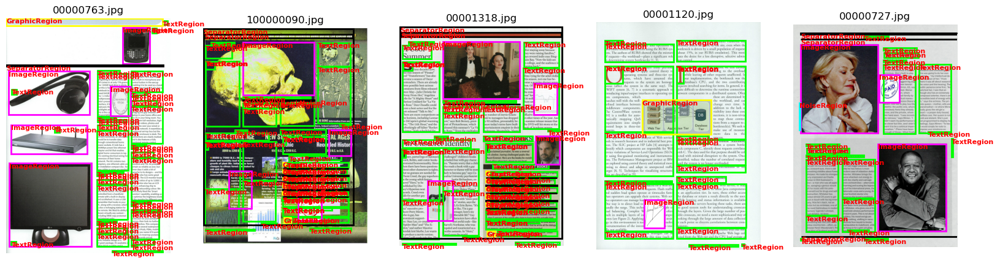

In [17]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import random

img_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Document_Layout_Analysis\Images"
xml_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Document_Layout_Analysis\PascalVOC"

img_files = os.listdir(img_folder)
xml_files = os.listdir(xml_folder)

label_colors = {

        "TextRegion": (0, 255, 0),     
        "ImageRegion": (255, 0, 255), 
        "GraphicRegion": (255, 255, 0),
        "NoiseRegion": (0, 255, 255),
        "ChartRegion": (255, 0, 0),
        "TableRegion": (0, 0, 255),
        "SeparatorRegion": (0, 0, 0),
        "MathsRegion": (255, 255, 255),
        "LineDrawingRegion": (128, 128, 128)   
    }


def plot_img_with_labels(img_folder, xml_folder):
    img_files = os.listdir(img_folder)
    xml_files = os.listdir(xml_folder)

    random_img_files = random.sample(img_files, 5)

    fig, axes = plt.subplots(1, 5, figsize=(20, 10))
    
    for i, img_file in enumerate(random_img_files):

        img_path = os.path.join(img_folder, img_file)
        img = cv2.imread(img_path)
        
        # Check if there exists a corresponding XML file
        xml_file = os.path.splitext(img_file)[0] + ".xml"
        if xml_file in xml_files:
            xml_path = os.path.join(xml_folder, xml_file)
            tree = ET.parse(xml_path)
            root = tree.getroot()
            
            axes[i].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            axes[i].set_title(img_file) 
            axes[i].axis("off")
                    
            # Parse XML and draw bounding boxes
            for obj in root.findall('object'):
                label = obj.find('name').text
                xmin = int(obj.find('bndbox/xmin').text)
                ymin = int(obj.find('bndbox/ymin').text)
                xmax = int(obj.find('bndbox/xmax').text)
                ymax = int(obj.find('bndbox/ymax').text)
                
                # Scale color values to the range of 0 to 1
                color = tuple(val / 255 for val in label_colors.get(label, (255, 255, 255)))
                
                rect = patches.Rectangle((xmin, ymin), xmax - xmin, ymax - ymin,
                                         linewidth=2, edgecolor=color, facecolor='none')
                axes[i].add_patch(rect)
                axes[i].text(xmin, ymin, label, color='r', fontsize=8, weight='bold', va='top')

    
    plt.show()

plot_img_with_labels(img_folder, xml_folder)

In [15]:
import os
import random
import cv2
import xml.etree.ElementTree as ET
import matplotlib.pyplot as plt
import albumentations as A
from PIL import ImageEnhance

def augment_data(img_folder, xml_pascal_folder, output_folder):

    img_files = os.listdir(img_folder)
    xml_files = os.listdir(xml_pascal_folder)

    #fig, axes = plt.subplots(num_augmented_images, 2, figsize=(10, 20))

    frame_png_path = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Sample Images\marco.png"

    for img_file in img_files:

        try:

            # Select a random image and corresponding XML file
            xml_file = os.path.splitext(img_file)[0] + ".xml"

            img_path = os.path.join(img_folder, img_file)
            xml_path = os.path.join(xml_pascal_folder, xml_file)

            # Add a frame to the image with probability 0.2
           
            if random.random() < 0.2:

                image = Image.open(img_path)

                myForegroundImage = Image.open(frame_png_path)
                myForegroundImage = myForegroundImage.resize(image.size)

                enhancer = ImageEnhance.Color(myForegroundImage)
                myForegroundImage = enhancer.enhance(random.uniform(0.5, 1.5))

                myMerged_image = Image.new("RGBA", image.size)
                myMerged_image.paste(image, (0, 0))

                _, _, _, mask = myForegroundImage.split()

                myMerged_image.paste(myForegroundImage, (0, 0), mask)

                img = cv2.cvtColor(np.array(myMerged_image), cv2.COLOR_RGB2BGR)
            
            else:
                img = cv2.imread(img_path)

            # Parse XML
            tree = ET.parse(xml_path)
            root = tree.getroot()

            # Extract object names and bounding boxes from XML
            obj_names = [obj.find('name').text for obj in root.findall('.//object')]
            bboxes = [[int(obj.find('bndbox').find(tag).text) for tag in ['xmin', 'ymin', 'xmax', 'ymax']] for obj in root.findall('.//object')]

            # Apply random augmentations
            aug = A.Compose([
                A.HorizontalFlip(p=0.5), # apply horizontal flip to 50% of images
                A.VerticalFlip(p=0.5), # apply vertical flip to 50% of images
                A.RandomBrightnessContrast(p=0.5), # apply random brightness and contrast
                A.GaussNoise(p=0.25),   # apply gaussian noise
                A.RandomGamma(p=0.2),  # apply random gamma
                A.RandomShadow(p=0.25), # apply random shadow
                A.Affine(rotate=[90, 90], p=0.25, mode=cv2.BORDER_CONSTANT, fit_output=True)

            ], bbox_params=A.BboxParams(format='pascal_voc', label_fields=['name']))

            # Apply augmentations
            augmented = aug(image=img, bboxes=bboxes, name=obj_names)
            img_aug = augmented['image']
            bboxes_aug = augmented['bboxes']

            # Filter out invalid bounding boxes
            valid_bboxes = []
            valid_names = []
            for bbox, name in zip(bboxes_aug, obj_names):
                xmin, ymin, xmax, ymax = bbox
                if xmax > xmin and ymax > ymin:
                    valid_bboxes.append(bbox)
                    valid_names.append(name)

            # Update XML with valid augmented bounding boxes
            for obj, bbox, name in zip(root.findall('.//object'), valid_bboxes, valid_names):
                for tag, coord in zip(['xmin', 'ymin', 'xmax', 'ymax'], bbox):
                    obj.find('bndbox').find(tag).text = str(int(coord))

            # Save augmented XML
            output_xml_path = os.path.join(output_folder+"/XML/", os.path.splitext(xml_file)[0]+"_aug.xml")
            tree.write(output_xml_path)

            # Save augmented image
            
            output_img_path = os.path.join(output_folder+"/IMG/", os.path.splitext(img_file)[0]+"_aug.jpg")
            cv2.imwrite(output_img_path, img_aug)

            # Show augmented image
            #axes[i, 0].imshow(cv2.cvtColor(np.array(image), cv2.COLOR_BGR2RGB))
            #axes[i, 0].set_title("Original Image")

            #axes[i, 1].imshow(cv2.cvtColor(img_aug, cv2.COLOR_BGR2RGB))
            #axes[i, 1].set_title("Augmented Image")

        except Exception as e:
            print(f"Error augmenting image {img_file}: {e}")
            pass 

pascal_voc = "PascalVOC/"
img_folder = final_root_dir + img_dir
xml_folder = final_root_dir + pascal_voc

augment_data(img_folder, xml_folder, output_folder="Augmented_Images")

Error augmenting image 00000394.jpg: y_max is less than or equal to y_min for bbox (0.35643115942028986, 0.6542056074766355, 0.7427536231884058, 0.6542056074766355, 'NoiseRegion').
Error augmenting image 00000406.jpg: 'NoneType' object has no attribute 'text'
Error augmenting image 00000407.jpg: y_max is less than or equal to y_min for bbox (0.2850658193372674, 0.5864259445001672, 0.7076713572401271, 0.5864259445001672, 'NoiseRegion').
Error augmenting image 00000673.jpg: Expected y_max for bbox (0.007389162561576354, 0.9960249858035207, 0.9954844006568144, 1.0011357183418512, 'NoiseRegion') to be in the range [0.0, 1.0], got 1.0011357183418512.
Error augmenting image 00000718.jpg: 'NoneType' object has no attribute 'text'
Error augmenting image 00000734.jpg: y_max is less than or equal to y_min for bbox (0.042761692650334075, 0.08928571428571429, 0.04320712694877506, 0.08928571428571429, 'NoiseRegion').
Error augmenting image 00000744.jpg: 'NoneType' object has no attribute 'text'
Err

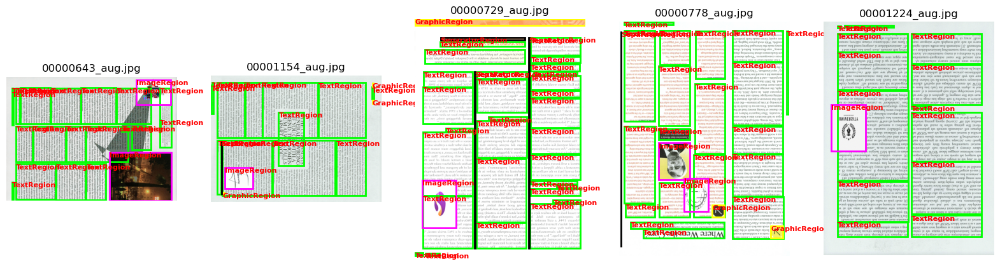

In [18]:
plot_img_with_labels("Augmented_Images/IMG", "Augmented_Images/XML")

---
### STEP 3: Final Dataset
---

In [20]:
data_directory_0 = "Augmented_Images/"
img_dir_0 = "IMG/"
anno_dir_0 = "XML/"


images = pd.DataFrame(columns=['id', 'file_name', 'width', 'height'])

for i, img_file in enumerate(os.listdir(data_directory_0+img_dir_0)):

    img = cv2.imread(data_directory_0+img_dir_0+img_file)
    h, w, _ = img.shape

    images.loc[i] = [i, img_file, w, h]

images.head()

,id,file_name,width,height
0,0,00000085_aug.jpg,2280,3257
1,1,00000086_aug.jpg,2442,3275
2,2,00000087_aug.jpg,2374,3254
3,3,00000088_aug.jpg,2359,3236
4,4,00000089_aug.jpg,2366,3162


In [21]:
data = pd.DataFrame(columns=['image_id', 'category_id', 'x_min', 'y_min', 'x_max', 'y_max'])

label_map_r = {"TextRegion": 0, "TitleRegion": 1, "ListRegion": 2, "TableRegion": 3, "ImageRegion": 4}

for i, xml_file in enumerate(os.listdir(data_directory_0+anno_dir_0)):

    tree = ET.parse(data_directory_0+anno_dir_0+xml_file)
    root = tree.getroot()

    for obj in root.findall('.//object'):

        label = obj.find('name').text

        if label not in label_map_r:
            continue

        bbox = obj.find('bndbox')
        xmin, ymin, xmax, ymax = [int(bbox.find(tag).text) for tag in ['xmin', 'ymin', 'xmax', 'ymax']]
       
        label = label_map_r[label]

        data.loc[len(data)] = [i, label, xmin, ymin, xmax, ymax]

data.head()

,image_id,category_id,x_min,y_min,x_max,y_max
0,0,0,1283,525,2141,591
1,0,0,1259,2963,2163,3009
2,0,0,303,3150,983,3172
3,0,0,183,3141,226,3167
4,0,0,121,2854,138,3047


In [34]:
# Save the images and annotations to CSV files

images.to_csv("images.csv", index=False)
data.to_csv("data.csv", index=False)

In [ ]:
import pandas as pd
import numpy as np
import pandas as pd 
from tqdm import tqdm
from tqdm import tqdm_notebook as tqdm # progress bar
from datetime import datetime
import time
import matplotlib.pyplot as plt
#from pycocotools.coco import COCO
import os, json, cv2, random
import skimage.io as io
import copy
from pathlib import Path
from typing import Optional


# torch
import torch

# Albumenatations
import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2

#from pycocotools.coco import COCO
from sklearn.model_selection import StratifiedKFold

# glob
from glob import glob

# numba
import numba
from numba import jit

import warnings
warnings.filterwarnings('ignore') #Ignore "future" warnings and Data-Frame-Slicing warnings.


# detectron2
from detectron2.structures import BoxMode
from detectron2 import model_zoo
from detectron2.config import get_cfg
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.engine import DefaultPredictor, DefaultTrainer, launch
from detectron2.evaluation import COCOEvaluator
from detectron2.structures import BoxMode
from detectron2.utils.visualizer import ColorMode
from detectron2.utils.logger import setup_logger
from detectron2.utils.visualizer import Visualizer

from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader, build_detection_train_loader
from detectron2.data import detection_utils as utils


from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader, build_detection_train_loader
from detectron2.data import detection_utils as utils
import detectron2.data.transforms as T
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

setup_logger()

<Logger detectron2 (DEBUG)>

In [2]:
# read images.csv
images = pd.read_csv("images.csv")
train_meta = pd.DataFrame(images)
train_meta.head()

,id,file_name,width,height
0,0,00000085_aug.jpg,2280,3257
1,1,00000086_aug.jpg,2442,3275
2,2,00000087_aug.jpg,2374,3254
3,3,00000088_aug.jpg,2359,3236
4,4,00000089_aug.jpg,2366,3162


In [3]:
data = pd.read_csv("data.csv")
train_df = pd.DataFrame(data)
train_df.head()

,image_id,category_id,x_min,y_min,x_max,y_max
0,0,0,1283,525,2141,591
1,0,0,1259,2963,2163,3009
2,0,0,303,3150,983,3172
3,0,0,183,3141,226,3167
4,0,0,121,2854,138,3047


In [4]:
label_map = {0: "Text", 1: "Title", 2: "List", 3:"Table", 4:"Figure"}

thing_classes = list(label_map.values())
thing_classes

['Text', 'Title', 'List', 'Table', 'Figure']

In [5]:
imgdir = "Augmented_Images/IMG/"

debug=False
split_mode="valid20" # all_train Or  valid20 
image_Width=601
image_Height=792

num_folds=5
Selected_fold=1

In [6]:
def get_PL_data_dicts(
    imgdir: Path,
    _train_df: pd.DataFrame,
    _train_meta: pd.DataFrame,
    use_cache: bool = True,
    target_indices: Optional[np.ndarray] = None,
    debug: bool = False,
    data_type:str="train"
   
):
    if debug:
            train_meta = train_meta.iloc[:100]  # For debug...
    dataset_dicts = []
    for index, train_meta_row in tqdm(_train_meta.iterrows(), total=len(_train_meta)):
                    record = {}
                    image_id,file_name, width,height = train_meta_row.values
                    filename = str(f'{imgdir}/{file_name}')
                    record["file_name"] = filename
                    record["image_id"] = image_id
                    record["width"] = width
                    record["height"] = height
                    objs = []
                    for index2, row in _train_df.query("image_id == @image_id").iterrows():
                        class_id = row["category_id"]
                        bbox_resized = [
                            float(row["x_min"]),
                            float(row["y_min"]),
                            float(row["x_max"]),
                            float(row["y_max"]),
                        ]
                        obj = {
                            "bbox": bbox_resized,
                            "bbox_mode": BoxMode.XYXY_ABS,
                            "category_id": class_id,
                        }
                        objs.append(obj)
                    record["annotations"] = objs
                    dataset_dicts.append(record)
                    
    if target_indices is not None:
        dataset_dicts = [dataset_dicts[i] for i in target_indices]

    return dataset_dicts

In [7]:
Data_Resister_training="PL_data_train";
Data_Resister_valid="PL_data_valid";

if split_mode == "all_train":
    DatasetCatalog.register(
        Data_Resister_training,
        lambda: get_PL_data_dicts(
            imgdir,
            train_df,
            train_meta,
            debug=debug,
            data_type="train"
        ),
    )
    MetadataCatalog.get(Data_Resister_training).set(thing_classes=thing_classes)
    
    
    dataset_dicts_train = DatasetCatalog.get(Data_Resister_training)
    metadata_dicts_train = MetadataCatalog.get(Data_Resister_training)
    
    
elif split_mode == "valid20":

    n_dataset = len(train_meta)
    n_train = int(n_dataset * 0.95)
    print("n_dataset", n_dataset, "n_train", n_train)
    rs = np.random.RandomState(12)
    inds = rs.permutation(n_dataset)
    train_inds, valid_inds = inds[:n_train], inds[n_train:]
    DatasetCatalog.register(
        Data_Resister_training,
        lambda: get_PL_data_dicts(
            imgdir,
            train_df,
            train_meta,
            target_indices=train_inds,
            debug=debug,
            data_type="train"
        ),
    )
    MetadataCatalog.get(Data_Resister_training).set(thing_classes=thing_classes)
    

    DatasetCatalog.register(
        Data_Resister_valid,
        lambda: get_PL_data_dicts(
            imgdir,
            train_df,
            train_meta,
            target_indices=valid_inds,
            debug=debug,
            data_type="val"
            ),
        )
    MetadataCatalog.get(Data_Resister_valid).set(thing_classes=thing_classes)
    
    dataset_dicts_train = DatasetCatalog.get(Data_Resister_training)
    metadata_dicts_train = MetadataCatalog.get(Data_Resister_training)

    dataset_dicts_valid = DatasetCatalog.get(Data_Resister_valid)
    metadata_dicts_valid = MetadataCatalog.get(Data_Resister_valid)
    
else:
    raise ValueError(f"[ERROR] Unexpected value split_mode={split_mode}")

n_dataset 426 n_train 404


  0%|          | 0/426 [00:00<?, ?it/s]

  0%|          | 0/426 [00:00<?, ?it/s]

In [8]:
dataset_dicts_train[11]

{'file_name': 'Augmented_Images/IMG//00000719_aug.jpg',
 'image_id': 124,
 'width': 2307,
 'height': 3114,
 'annotations': [{'bbox': [1920.0, 84.0, 2186.0, 125.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [1590.0, 211.0, 2236.0, 291.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [1587.0, 299.0, 2236.0, 2475.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [1587.0, 2491.0, 2234.0, 2921.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [885.0, 2535.0, 1535.0, 2922.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [889.0, 79.0, 1538.0, 502.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [889.0, 518.0, 1474.0, 551.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [185.0, 80.0, 837.0, 1730.0],
   'bbox_mode': <BoxMode.XYXY_ABS: 0>,
   'category_id': 0},
  {'bbox': [181.0, 1747.0, 835.0, 2616.0],
   'b

---
### STEP 4: Data Visualization
---

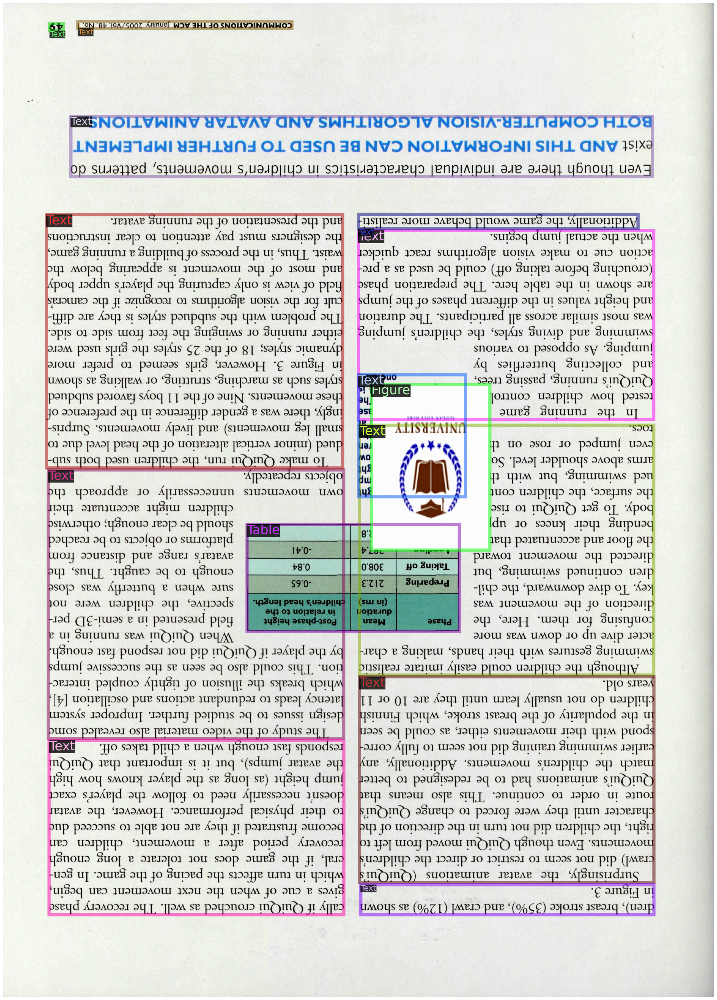

In [9]:

fig = plt.figure(figsize =(40,40)) 
ax = fig.add_subplot(1,1,1)

d=dataset_dicts_valid[1]
img = cv2.imread(d["file_name"]) 
v = Visualizer(img[:, :, ::-1], metadata=metadata_dicts_valid, scale=1.5, instance_mode=ColorMode.IMAGE_BW)
out = v.draw_dataset_dict(d) 

ax.grid(False) 
ax.axis('off') 
ax.imshow(out.get_image()[:, :, ::-1])

---
## Annotations for Training
---

In [ ]:

import os
import xml.etree.ElementTree as ET
import json
from PIL import Image

label_map = {1: "TextRegion", 2: "ImageRegion", 3: "TableRegion", 4: "MathsRegion", 5: "SeparatorRegion", 6: "OtherRegion"}
inverse_label_map = {v: k for k, v in label_map.items()}

# Function to parse XML annotations
def parse_xml_annotation(xml_file):
    tree = ET.parse(xml_file)
    root = tree.getroot()

    annotations = []

    # Extract object annotations

    for obj in root.findall('object'):

        if obj.find('name').text not in inverse_label_map:
            continue

        category_name = inverse_label_map[obj.find('name').text]
        print(category_name)
        bbox = obj.find('bndbox')

        xmin = int(bbox.find('xmin').text)
        ymin = int(bbox.find('ymin').text)
        xmax = int(bbox.find('xmax').text)
        ymax = int(bbox.find('ymax').text)

        x, y, w, h = xmin, ymin, xmax - xmin, ymax - ymin
        segmentation = [[x, y, x+w, y, x, y+h, x+w, y+h]]
    

        annotations.append({
            "category_id": category_name,
            "bbox": [xmin, ymin, xmax - xmin, ymax - ymin],
            "segmentation": segmentation,
            "area": (xmax - xmin) * (ymax - ymin),
            "iscrowd": 0
        })

    return annotations

# Path to images and annotations folders
images_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Augmented_Images\IMG"
annotations_folder = r"C:\Users\User\OneDrive\Escritorio\Detectron2LayoutParser\Augmented_Images\XML"

# Initialize COCO annotation dictionary
coco_annotation = {
    "images": [],
    "categories": [{"id": idx, "name": label_map[idx]} for idx in label_map.keys()],
    "annotations": [],
}

image_id = 0
annotation_id = 0

drive_path = "/content/drive/My Drive/Synthesis Project/Data/Augmented_Images/IMG/"

# Iterate through each image and corresponding annotations
for image_filename in os.listdir(images_folder):
    if image_filename.endswith(".jpg"):
        image_id += 1
        image_width, image_height = 0, 0

        # Extract image dimensions
        image_path = os.path.join(images_folder, image_filename)

        with Image.open(image_path) as img:
            image_width, image_height = img.size

        # Add image information to COCO annotation
        coco_annotation["images"].append({
            "id": image_id,
            "file_name":os.path.join(drive_path, image_filename),
            "width": image_width,
            "height": image_height
        })

        # Parse XML annotation file
        xml_filename = os.path.splitext(image_filename)[0] + ".xml"
        xml_file = os.path.join(annotations_folder, xml_filename)
        annotations = parse_xml_annotation(xml_file)

        # Add annotations to COCO annotation
        for ann in annotations:
            ann["id"] = annotation_id
            ann["image_id"] = image_id
            coco_annotation["annotations"].append(ann)
            annotation_id += 1

# Save COCO annotation to JSON file
with open('annotations.json', 'w') as f:
    json.dump(coco_annotation, f)